# Animation Preparation Script

In [1]:
%matplotlib inline
import xarray as xr
import cmocean as cmo
import pandas as pd
from glob import glob

import numpy as np
import numpy.ma as ma

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.path as mpath
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, mark_inset
from matplotlib.markers import MarkerStyle
import matplotlib.ticker as mticker
from matplotlib.colors import BoundaryNorm
from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec

import cartopy
import cartopy.crs as ccrs
import shapely.geometry as sgeom
from cartopy.geodesic import Geodesic

import warnings
from shapely.errors import ShapelyDeprecationWarning
warnings.filterwarnings("ignore", category=ShapelyDeprecationWarning)

In [2]:
# Load data
topo = xr.open_dataset('/nethome/5867800/grid/adapted_bathymetry.nc')

In [3]:
# Load variables
lats = topo.variables['T_LAT_2D'][:,:]
lons = topo.variables['T_LON_2D'][:,:]
bath = topo.variables['Bathymetry'][:,:]

In [4]:
### Define functions
def divide_longitude(lons, lats, var):
    '''Split data into sections east and west of the prime meridian'''
    
    lons_greater = ma.masked_greater(lons, -0.01)
    lons_lesser = ma.masked_less(lons, 0.)

    lats_greater = ma.MaskedArray(lats, mask=lons_greater.mask)
    lats_lesser = ma.MaskedArray(lats, mask=lons_lesser.mask)

    var_greater = ma.MaskedArray(var, mask=lons_greater.mask)
    var_lesser = ma.MaskedArray(var, mask=lons_lesser.mask)
    
    return lons_greater, lons_lesser, lats_greater, lats_lesser, var_greater, var_lesser

def mask_land(lons, lats, bathy, var):
    '''Mask land (elevation above zero)'''
    
    bathy_land = ma.masked_greater(bathy, 0.)
    lons_land = ma.MaskedArray(lons, mask=bathy_land.mask)
    lats_land = ma.MaskedArray(lats, mask=bathy_land.mask)
    var_land = ma.MaskedArray(var, mask=bathy_land.mask)
    
    return lons_land, lats_land, var_land

# General settings

In [5]:
### Settings plot
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
projection = ccrs.NearsidePerspective(central_latitude=-67, central_longitude=-20, satellite_height=1500000)

In [6]:
### Locations
x696p, y696p = -42.933067, -61.849083   # present-day
x696, y696 = -57., -67.5                # paleo lon/lat visually
dist = 10

In [7]:
# Forwards
lonsfw = np.array([-55., -50., -45., -40., -35., -30., -25., -20.,
                   -15., -10.,  -5.,   0.,   5.,  10.,  15.,  20.,
                    25.,  30.,  35.,  40.,  45.,  50.,  55.,  60.,
                   -57.82330253, -59.25, -60.08662877, -60.01036191, -58.82106809])
latsfw = np.array([-77.99537227, -78.45787684, -79.17977465, -79.75459498, -79.99027112, -80.07689735, -79.9997914 , -80.12097168,
                   -79.24559138, -78.39033646, -77.33178711, -76.13251966, -75.17986379, -74.68456009, -73.6896764 , -73.53134648,
                   -72.9724492 , -72.3117251 , -72.29006817, -72.16268516, -70.86573029, -68.58359528, -68.58359528, -66.59729004,
                   -77.        , -75.        , -73.        , -71.        , -69.        ])
# Backwards
lonsbw = np.array([-57.04998779, -57.0249939, -57., -56.9750061, -56.95001221,
                   -57.04998779, -57.0249939, -57., -56.9750061, -56.95001221,
                   -57.04998779, -57.0249939, -57., -56.9750061, -56.95001221,
                   -57.04998779, -57.0249939, -57., -56.9750061, -56.95001221,
                   -57.04998779, -57.0249939, -57., -56.9750061, -56.95001221])
latsbw = np.array([-67.5270462, -67.5270462, -67.5270462, -67.5270462, -67.5270462,
                   -67.5164814, -67.5164814, -67.5164814, -67.5164814, -67.5164814,
                   -67.5059166, -67.5059166, -67.5059166, -67.5059166, -67.5059166,
                   -67.49535179, -67.49535179, -67.49535179, -67.49535179, -67.49535179,
                   -67.48478699, -67.48478699, -67.48478699, -67.48478699, -67.48478699])

In [8]:
### Fix latitudes, longitudes and bathymetry
lonsg, lonsl, latsg, latsl, varg, varl = divide_longitude(lons, lats, bath)
lons = np.concatenate((lonsg[:,2650:], lonsg[:,:850], lonsl[:,850:2650]), axis=1) # -179.95 to -85.05, -84.95 to -0.05, 0.05 to 179.95
lats = np.concatenate((latsg[:,2650:], latsg[:,:850], latsl[:,850:2650]), axis=1)
bath = np.concatenate((varg[:,2650:], varg[:,:850], varl[:,850:2650]), axis=1)

In [9]:
### Define plotting functions
def prepare_plot_NSP(figsize=(10,4)):

    projection=ccrs.NearsidePerspective(central_latitude=-67, central_longitude=-10, satellite_height=1500000)
    
    fig, ax = plt.subplots(1, 1, subplot_kw={'projection': projection}, figsize=figsize)
    
    ax.set_global()
    ax.gridlines(linestyle='--')
    ax.set_boundary(circle, transform=ax.transAxes)
    
    ax.contour(lonsg, latsg, varg, levels=[0], transform=ccrs.PlateCarree(), colors='k', zorder=10)
    ax.contour(lonsl, latsl, varl, levels=[0], transform=ccrs.PlateCarree(), colors='k', zorder=10)
    
    ax.plot(x696, y696, color='r', marker='*', markersize=10, markeredgecolor='black', markeredgewidth=.5, transform=ccrs.PlateCarree(), zorder=10) # Site 696
    
    return fig, ax

def prepare_plot_SPS(figsize=(10,4), north=-50):

    projection=ccrs.SouthPolarStereo()
    
    fig, ax = plt.subplots(1, 1, subplot_kw={'projection': projection}, figsize=figsize)
    
    ax.set_extent([-180, 180, -90, north], ccrs.PlateCarree())
    ax.gridlines(linestyle='--')
    ax.set_boundary(circle, transform=ax.transAxes)
    
    ax.contour(lonsg, latsg, varg, levels=[0], transform=ccrs.PlateCarree(), colors='k', zorder=10)
    ax.contour(lonsl, latsl, varl, levels=[0], transform=ccrs.PlateCarree(), colors='k', zorder=10)
    
    ax.plot(x696, y696, color='r', marker='*', markersize=10, markeredgecolor='black', markeredgewidth=.5, transform=ccrs.PlateCarree(), zorder=10) # Site 696
    
    return fig, ax

def prepare_plot_SPS_zoom(figsize=(10,4), west=-180., east=180., south=-90., north=-50):

    projection=ccrs.SouthPolarStereo()
    
    fig, ax = plt.subplots(1, 1, subplot_kw={'projection': projection}, figsize=figsize)
    
    ax.set_extent([west, east, south, north], ccrs.PlateCarree())
    ax.gridlines(linestyle='--')
    
    ax.contour(lonsg, latsg, varg, levels=[0], transform=ccrs.PlateCarree(), colors='k', zorder=10)
    ax.contour(lonsl, latsl, varl, levels=[0], transform=ccrs.PlateCarree(), colors='k', zorder=10)
    
    ax.plot(x696, y696, color='r', marker='*', markersize=10, markeredgecolor='black', markeredgewidth=.5, transform=ccrs.PlateCarree(), zorder=10) # Site 696
    
    return fig, ax

## Prepare trajectories

In [10]:
### Thesis figures
C4g = xr.open_zarr('/nethome/5867800/active/29p_5y_int_30d_1hdtar_C4g.zarr')    # grounding, C4 (10000)

dat = C4g
name = 'C4g'
label = 'C4 icebergs'

In [11]:
gcd = (np.deg2rad(0.1)*6371e3)   # gridcell distance [m]

In [12]:
min_distances = dat['distance'][:,:].groupby('trajectory').min(dim='obs')

In [13]:
filtered_ds = dat.where(min_distances <= gcd, drop=True)

/nethome/5867800/.conda/envs/py3_parcels/lib/python3.8/site-packages/dask/array/reductions.py:579: RuntimeWarning: All-NaN slice encountered
  return np.nanmin(x_chunk, axis=axis, keepdims=keepdims)


## Animation

In [14]:
%matplotlib inline

import matplotlib.animation
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from datetime import timedelta as delta

warnings.filterwarnings('ignore')
with warnings.catch_warnings():
    warnings.filterwarnings('ignore', r'All-NaN (slice|axis) encountered')

In [15]:
### Eocene data Nooteboom et al. (2022)
data_path_ocean = '/storage/shared/pop/p21a.EO38Ma.tx0.1.2pic_control/daily/'
mesh_mask = '/nethome/5867800/grid/edited_grid_coordinates_pop_tx0.1_38ma.nc'

grid = xr.open_dataset(mesh_mask)

In [20]:
# Select trajectory
data_xarray = filtered_ds.isel(trajectory=slice(143,144))

outputdt = delta(days=30)
timerange = np.arange(np.nanmin(data_xarray['time'].values),
                      np.nanmax(data_xarray['time'].values), 
                      outputdt)  # timerange in nanoseconds

time_id = np.where(data_xarray['time'] == timerange[0]) # Indices of the data where time = 0

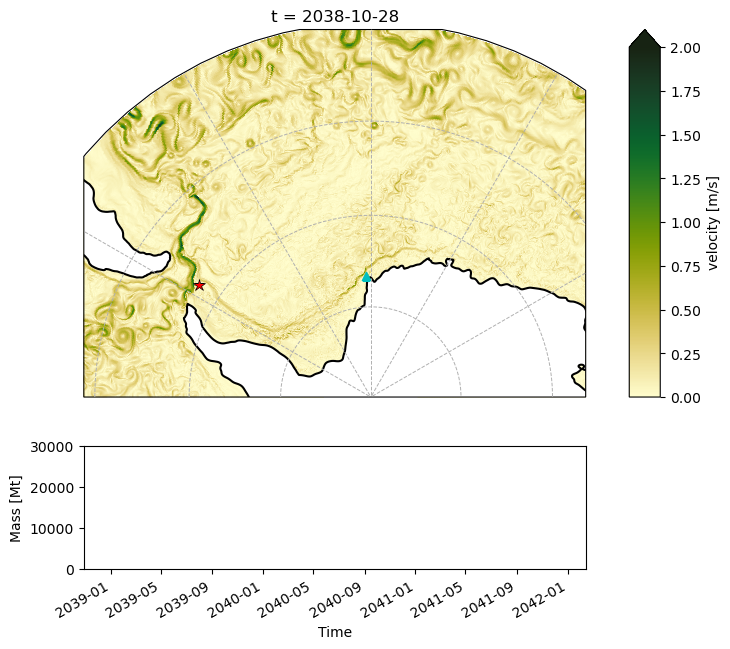

In [32]:
### Define the figure and axis
fig = plt.figure(figsize=(8,7))

gs = GridSpec(2, 1, height_ratios=[3,1])   # one overall figure: 2 row, 2 column
gs0 = GridSpecFromSubplotSpec(1, 2, subplot_spec=gs[0], wspace=0.0, width_ratios=(19, 1))   # fill top row: 1 row, 2 columns
gs1 = GridSpecFromSubplotSpec(1, 3, subplot_spec=gs[1], wspace=0.0, width_ratios=(1.4, 16.2, 2.4))   # fill bottom row: 1 rows, 2 columns

# initialize the cartopy and colorbar axes
ax = fig.add_subplot(gs0[0,0], projection=ccrs.SouthPolarStereo())
cb_ax = fig.add_subplot(gs0[0,1])
m_ax = fig.add_subplot(gs1[0,1])

# Adapt border
ax.set_extent([-50, 35, -90, -50], ccrs.PlateCarree())
ylim = [-90,-50]
xlim = [-90,90]
rect = mpath.Path([[xlim[0], ylim[0]],
                   [xlim[1], ylim[0]],
                   [xlim[1], ylim[1]],
                   [xlim[0], ylim[1]],
                   [xlim[0], ylim[0]],
                   ]).interpolated(40)
proj_to_data   = ccrs.PlateCarree()._as_mpl_transform(ax) - ax.transData
rect_in_target = proj_to_data.transform_path(rect)
ax.set_boundary(rect_in_target)

# ODP Site 696
ax.plot(x696, y696, color='r', marker='*', markersize=9, markeredgecolor='black', markeredgewidth=.5,
        transform=ccrs.PlateCarree(), zorder=3)

# Coastlines
ax.contour(lons[:760,850:2700], lats[:760,850:2700], bath[:760,850:2700], levels=[0],
           transform=ccrs.PlateCarree(), colors='k', zorder=2)
ax.contourf(lons[:760,850:2700], lats[:760,850:2700], bath[:760,850:2700], levels=[0, 1e10],
            transform=ccrs.PlateCarree(), colors=['white'], zorder=1)
ax.scatter(1, -78.4, transform=ccrs.PlateCarree(), color='white', zorder=3, s=40)

# Gridlines
# -60, -30, 0, 30, 60 W/E (only lines)
gl0 = ax.gridlines(linestyle='--', linewidth=.7, draw_labels=False, x_inline=False, y_inline=False,
                   crs=ccrs.PlateCarree(), zorder=5)
gl0.xlocator = mticker.FixedLocator(np.arange(-60,61,30))
gl0.ylocator = mticker.FixedLocator([])
# 90, 80, 70, 60 S (only lines)
gl1 = ax.gridlines(linestyle='--', linewidth=.7, draw_labels=False, x_inline=False, y_inline=False,
                   crs=ccrs.PlateCarree(), zorder=5)
gl1.xlocator = mticker.FixedLocator([])
gl1.ylocator = mticker.FixedLocator(np.arange(-90,-59,10))
# 50 S (only lines)
gl2 = ax.gridlines(linestyle='-', linewidth=1, color='k', draw_labels=False, x_inline=False, y_inline=False,
                   crs=ccrs.PlateCarree(), zorder=5)
gl2.xlocator = mticker.FixedLocator([])
gl2.ylocator = mticker.FixedLocator(np.arange(-50,-49,10))

### Background (velocity)
tm = str(data_xarray['time'].values[0,0])[2:4] + str(data_xarray['time'].values[0,0])[5:7] + str(data_xarray['time'].values[0,0])[8:10]
ds = xr.open_dataset(f'/storage/shared/pop/p21a.EO38Ma.tx0.1.2pic_control/daily/vars_first600m_eocene_2pic_pop_00{tm}.nc')
data = np.sqrt((ds['UVEL'][0,0,:750,:])**2 + (ds['VVEL'][0,0,:750,:])**2) / 100.
kw = dict(cmap=cmo.cm.speed, vmin=0, vmax=2, shading='flat')

cm = ax.pcolormesh(grid['U_LON_2D'][:750,:], grid['U_LAT_2D'][:750,:], data[:-1,:-1], transform=ccrs.PlateCarree(), **kw, zorder=0)
                    # cmap=cmo.cm.speed, vmin=0, vmax=2, shading='flat')

### Iceberg position
scatter = ax.scatter(data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id],
                     transform=ccrs.PlateCarree(), marker='^', color='c', zorder=2)
### Trajectory
traj, = ax.plot(data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id],
                     transform=ccrs.PlateCarree(), color='darkcyan', zorder=1)

t = str(timerange[0].astype('datetime64[D]'))
title = ax.set_title('t = '+t)



#=================================================================================================#
### Colorbar
fig.colorbar(cm, cax=cb_ax, orientation='vertical', label=r'velocity [m/s]', extend='max')


#=================================================================================================#
### Mass
mass, = m_ax.plot(data_xarray['time'].values[time_id], data_xarray['M'].values[time_id]*1e-9,
                     color='darkcyan')
m_ax.set_ylim(0,30000)
m_ax.set_ylabel('Mass [Mt]')
m_ax.set_xlim(np.nanmin(data_xarray['time'].values), np.nanmax(data_xarray['time'].values))
m_ax.set_xlabel('Time')
for label in m_ax.get_xticklabels(which='major'):
    label.set(rotation=30, horizontalalignment='right')


#=================================================================================================#
def animate(i):
    t = str(timerange[i].astype('datetime64[D]'))
    title.set_text('t = '+t)
    
    time_id = np.where(data_xarray['time'] == timerange[i])
    
    tm = str(data_xarray['time'].values[0,i])[2:4] + str(data_xarray['time'].values[0,i])[5:7] + str(data_xarray['time'].values[0,0])[8:10]
    ds = xr.open_dataset(f'/storage/shared/pop/p21a.EO38Ma.tx0.1.2pic_control/daily/vars_first600m_eocene_2pic_pop_00{tm}.nc')
    data = np.sqrt((ds['UVEL'][0,0,:750,:])**2 + (ds['VVEL'][0,0,:750,:])**2) / 100.
    cm.set_array(data[:-1,:-1])
    
    scatter.set_offsets(np.c_[data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id]])
    traj.set_data(data_xarray['lon'].values[:,:i+1], data_xarray['lat'].values[:,:i+1])
    
    # Mass
    mass.set_data(data_xarray['time'].values[:,:i+1], data_xarray['M'].values[:,:i+1]*1e-9)

anim = FuncAnimation(fig, animate, frames = len(timerange), interval=750)

In [33]:
HTML(anim.to_jshtml())

In [36]:
f = r'/nethome/5867800/active/animationMM2.mp4'
writervideo = matplotlib.animation.FFMpegWriter(fps=12) 
anim.save(f, writer=writervideo,dpi=600)

In [22]:
# Select trajectories
# data_xarray = filtered_ds.isel(trajectory=[4, 143, 260, 320])
data_xarray = filtered_ds.isel(trajectory=[4, 47, 143, 191, 260, 320, 329, 341]) # new

outputdt = delta(days=30)
timerange = np.arange(np.nanmin(data_xarray['time'].values),
                      np.nanmax(data_xarray['time'].values) + np.timedelta64(20,'D'), 
                      outputdt)  # timerange in nanoseconds

time_id = np.where(data_xarray['time'] == timerange[0]) # Indices of the data where time = 0

In [23]:
timerange[-1] = np.nanmax(data_xarray['time'].values)

In [18]:
from cycler import cycler
custom_cycler = (cycler(color=['#332288', '#117733', '#44AA99', '#88CCEE', '#DDCC77', '#CC6677', '#AA4499', '#882255']))

color=['#332288', '#117733', '#44AA99', '#88CCEE', '#DDCC77', '#CC6677', '#AA4499', '#882255']

In [22]:
data_xarray['time'][1,0].values

numpy.datetime64('2038-05-31T00:00:00.000000000')

In [21]:
data_xarray['time'].values

array([['2038-01-31T00:00:00.000000000', '2038-03-02T00:00:00.000000000',
        '2038-04-01T00:00:00.000000000', '2038-05-01T00:00:00.000000000',
        '2038-05-31T00:00:00.000000000', '2038-06-30T00:00:00.000000000',
        '2038-07-30T00:00:00.000000000', '2038-08-29T00:00:00.000000000',
        '2038-09-28T00:00:00.000000000', '2038-10-28T00:00:00.000000000',
        '2038-11-27T00:00:00.000000000', '2038-12-27T00:00:00.000000000',
        '2039-01-26T00:00:00.000000000', '2039-02-25T00:00:00.000000000',
        '2039-03-27T00:00:00.000000000', '2039-04-26T00:00:00.000000000',
        '2039-05-26T00:00:00.000000000', '2039-06-25T00:00:00.000000000',
        '2039-07-25T00:00:00.000000000', '2039-08-24T00:00:00.000000000',
        '2039-09-23T00:00:00.000000000', '2039-10-23T00:00:00.000000000',
        '2039-11-22T00:00:00.000000000', '2039-12-22T00:00:00.000000000',
        '2040-01-21T00:00:00.000000000', '2040-02-20T00:00:00.000000000',
        '2040-03-21T00:00:00.000000000

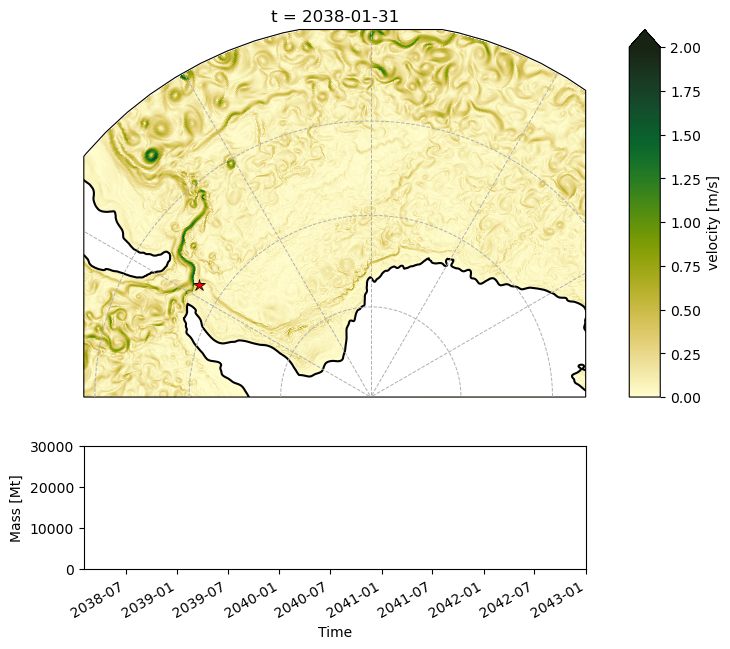

In [24]:
### Define the figure and axis ### DEZE WERKT !!!
fig = plt.figure(figsize=(8,7))

gs = GridSpec(2, 1, height_ratios=[3,1])   # one overall figure: 2 row, 2 column
gs0 = GridSpecFromSubplotSpec(1, 2, subplot_spec=gs[0], wspace=0.0, width_ratios=(19, 1))   # fill top row: 1 row, 2 columns
gs1 = GridSpecFromSubplotSpec(1, 3, subplot_spec=gs[1], wspace=0.0, width_ratios=(1.4, 16.2, 2.4))   # fill bottom row: 1 rows, 2 columns

# initialize the cartopy and colorbar axes
ax = fig.add_subplot(gs0[0,0], projection=ccrs.SouthPolarStereo())
cb_ax = fig.add_subplot(gs0[0,1])
m_ax = fig.add_subplot(gs1[0,1])

# Adapt border
ax.set_extent([-50, 35, -90, -50], ccrs.PlateCarree())
ylim = [-90,-50]
xlim = [-90,90]
rect = mpath.Path([[xlim[0], ylim[0]],
                   [xlim[1], ylim[0]],
                   [xlim[1], ylim[1]],
                   [xlim[0], ylim[1]],
                   [xlim[0], ylim[0]],
                   ]).interpolated(40)
proj_to_data   = ccrs.PlateCarree()._as_mpl_transform(ax) - ax.transData
rect_in_target = proj_to_data.transform_path(rect)
ax.set_boundary(rect_in_target)

# ODP Site 696
ax.plot(x696, y696, color='r', marker='*', markersize=9, markeredgecolor='black', markeredgewidth=.5,
        transform=ccrs.PlateCarree(), zorder=3)

# Coastlines
ax.contour(lons[:760,850:2700], lats[:760,850:2700], bath[:760,850:2700], levels=[0],
           transform=ccrs.PlateCarree(), colors='k', zorder=2)
ax.contourf(lons[:760,850:2700], lats[:760,850:2700], bath[:760,850:2700], levels=[0, 1e10],
            transform=ccrs.PlateCarree(), colors=['white'], zorder=1)
ax.scatter(1, -78.4, transform=ccrs.PlateCarree(), color='white', zorder=3, s=40)

# Gridlines
# -60, -30, 0, 30, 60 W/E (only lines)
gl0 = ax.gridlines(linestyle='--', linewidth=.7, draw_labels=False, x_inline=False, y_inline=False,
                   crs=ccrs.PlateCarree(), zorder=5)
gl0.xlocator = mticker.FixedLocator(np.arange(-60,61,30))
gl0.ylocator = mticker.FixedLocator([])
# 90, 80, 70, 60 S (only lines)
gl1 = ax.gridlines(linestyle='--', linewidth=.7, draw_labels=False, x_inline=False, y_inline=False,
                   crs=ccrs.PlateCarree(), zorder=5)
gl1.xlocator = mticker.FixedLocator([])
gl1.ylocator = mticker.FixedLocator(np.arange(-90,-59,10))
# 50 S (only lines)
gl2 = ax.gridlines(linestyle='-', linewidth=1, color='k', draw_labels=False, x_inline=False, y_inline=False,
                   crs=ccrs.PlateCarree(), zorder=5)
gl2.xlocator = mticker.FixedLocator([])
gl2.ylocator = mticker.FixedLocator(np.arange(-50,-49,10))

### Background (velocity)
tm = str(data_xarray['time'].values[0,0])[2:4] + str(data_xarray['time'].values[0,0])[5:7] + str(data_xarray['time'].values[0,0])[8:10]
ds = xr.open_dataset(f'/storage/shared/pop/p21a.EO38Ma.tx0.1.2pic_control/daily/vars_first600m_eocene_2pic_pop_00{tm}.nc')
data = np.sqrt((ds['UVEL'][0,0,:750,:])**2 + (ds['VVEL'][0,0,:750,:])**2) / 100.
kw = dict(cmap=cmo.cm.speed, vmin=0, vmax=2, shading='flat')

cm = ax.pcolormesh(grid['U_LON_2D'][:750,:], grid['U_LAT_2D'][:750,:], data[:-1,:-1], transform=ccrs.PlateCarree(), **kw, zorder=0)
                    # cmap=cmo.cm.speed, vmin=0, vmax=2, shading='flat')

### Iceberg position
scatter0 = ax.scatter([], [], transform=ccrs.PlateCarree(), marker='^', zorder=2, color=color[0])
scatter1 = ax.scatter([], [], transform=ccrs.PlateCarree(), marker='^', zorder=2, color=color[1])
scatter2 = ax.scatter([], [], transform=ccrs.PlateCarree(), marker='^', zorder=2, color=color[2])
# scatter3 = ax.scatter([], [], transform=ccrs.PlateCarree(), marker='^', zorder=2, color=color[3])
# scatter4 = ax.scatter([], [], transform=ccrs.PlateCarree(), marker='^', zorder=2, color=color[4])
# scatter5 = ax.scatter([], [], transform=ccrs.PlateCarree(), marker='^', zorder=2, color=color[5])
# scatter6 = ax.scatter([], [], transform=ccrs.PlateCarree(), marker='^', zorder=2, color=color[6])
# scatter7 = ax.scatter([], [], transform=ccrs.PlateCarree(), marker='^', zorder=2, color=color[7])
# ax.set_prop_cycle(custom_cycler)
# scatter = ax.scatter([], [],#data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id],
#                      transform=ccrs.PlateCarree(), marker='^',zorder=2)
# scatter0 = ax.scatter(data_xarray['lon'].values[0,time_id], data_xarray['lat'].values[0,time_id],
#                      transform=ccrs.PlateCarree(), marker='^', color='#332288', zorder=2)#117733
# scatter1 = ax.scatter(data_xarray['lon'].values[1,time_id], data_xarray['lat'].values[1,time_id],
#                      transform=ccrs.PlateCarree(), marker='^', color='#117733', zorder=2)
# scatter2 = ax.scatter(data_xarray['lon'].values[2,time_id], data_xarray['lat'].values[2,time_id],
#                      transform=ccrs.PlateCarree(), marker='^', color='#44AA99', zorder=2)
# scatter3 = ax.scatter(data_xarray['lon'].values[3,time_id], data_xarray['lat'].values[3,time_id],
#                      transform=ccrs.PlateCarree(), marker='^', color='c', zorder=2)

### Trajectory
traj0, = ax.plot([], [], transform=ccrs.PlateCarree(), zorder=1, color=color[0])
traj1, = ax.plot([], [], transform=ccrs.PlateCarree(), zorder=1, color=color[1])
traj2, = ax.plot([], [], transform=ccrs.PlateCarree(), zorder=1, color=color[2])
# traj3, = ax.plot([], [], transform=ccrs.PlateCarree(), zorder=1, color=color[3])
# traj4, = ax.plot([], [], transform=ccrs.PlateCarree(), zorder=1, color=color[4])
# traj5, = ax.plot([], [], transform=ccrs.PlateCarree(), zorder=1, color=color[5])
# traj6, = ax.plot([], [], transform=ccrs.PlateCarree(), zorder=1, color=color[6])
# traj7, = ax.plot([], [], transform=ccrs.PlateCarree(), zorder=1, color=color[7])
# ax.set_prop_cycle(custom_cycler)
# traj, = ax.plot([], [],#data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id],
#                      transform=ccrs.PlateCarree(), zorder=1)
# traj0, = ax.plot(data_xarray['lon'].values[0,time_id], data_xarray['lat'].values[0,time_id],
#                      transform=ccrs.PlateCarree(), color='#332288', zorder=1)
# traj1, = ax.plot(data_xarray['lon'].values[1,time_id], data_xarray['lat'].values[1,time_id],
#                      transform=ccrs.PlateCarree(), color='#117733', zorder=1)
# traj2, = ax.plot(data_xarray['lon'].values[2,time_id], data_xarray['lat'].values[2,time_id],
#                      transform=ccrs.PlateCarree(), color='#44AA99', zorder=1)
# traj3, = ax.plot(data_xarray['lon'].values[3,time_id], data_xarray['lat'].values[3,time_id],
#                      transform=ccrs.PlateCarree(), color='darkcyan', zorder=1)

t = str(timerange[0].astype('datetime64[D]'))
title = ax.set_title('t = '+t)



#=================================================================================================#
### Colorbar
fig.colorbar(cm, cax=cb_ax, orientation='vertical', label=r'velocity [m/s]', extend='max')


#=================================================================================================#
### Mass
mass0, = m_ax.plot([], [], color=color[0])
mass1, = m_ax.plot([], [], color=color[1])
mass2, = m_ax.plot([], [], color=color[2])
# mass3, = m_ax.plot([], [], color=color[3])
# mass4, = m_ax.plot([], [], color=color[4])
# mass5, = m_ax.plot([], [], color=color[5])
# mass6, = m_ax.plot([], [], color=color[6])
# mass7, = m_ax.plot([], [], color=color[7])
# m_ax.set_prop_cycle(custom_cycler)
# mass, = m_ax.plot([], [])#data_xarray['time'].values[time_id], data_xarray['M'].values[time_id]*1e-9)
# mass0, = m_ax.plot(data_xarray['time'].values[0,time_id], data_xarray['M'].values[0,time_id]*1e-9,
#                      color='darkcyan')
# mass1, = m_ax.plot([], [],#data_xarray['time'].values[1,time_id], data_xarray['M'].values[1,time_id]*1e-9,
#                      color='darkcyan')
# mass2, = m_ax.plot([], [],#data_xarray['time'].values[2,time_id], data_xarray['M'].values[2,time_id]*1e-9,
#                      color='darkcyan')
# mass3, = m_ax.plot([], [],#data_xarray['time'].values[3,time_id], data_xarray['M'].values[3,time_id]*1e-9,
#                      color='darkcyan')
m_ax.set_ylim(0,30000)
m_ax.set_ylabel('Mass [Mt]')
m_ax.set_xlim(np.nanmin(data_xarray['time'].values), np.datetime64('2043-01-01T00:00:00.000000000'))#np.nanmax(data_xarray['time'].values))
m_ax.set_xlabel('Time')
for label in m_ax.get_xticklabels(which='major'):
    label.set(rotation=30, horizontalalignment='right')


#=================================================================================================#
def animate(i):
    t = str(timerange[i].astype('datetime64[D]'))
    title.set_text('t = '+t)
    
    time_id = np.where(data_xarray['time'] == timerange[i])
    
    # tm = str(data_xarray['time'].values[0,i])[2:4] + str(data_xarray['time'].values[0,i])[5:7] + str(data_xarray['time'].values[0,i])[8:10]
    tm = str(timerange[i])[2:4] + str(timerange[i])[5:7] + str(timerange[i])[8:10]
    print(i, t, tm)
    if (tm != '380431') or (tm != '380631'):
        ds = xr.open_dataset(f'/storage/shared/pop/p21a.EO38Ma.tx0.1.2pic_control/daily/vars_first600m_eocene_2pic_pop_00{tm}.nc')
        data = np.sqrt((ds['UVEL'][0,0,:750,:])**2 + (ds['VVEL'][0,0,:750,:])**2) / 100.
        # cm.set_array(data[:-1,:-1])
    
    scatter0.set_offsets(np.c_[data_xarray['lon'].values[0,i], data_xarray['lat'].values[0,i]])
    traj0.set_data(data_xarray['lon'].values[0,:i+1], data_xarray['lat'].values[0,:i+1])
    scatter1.set_offsets(np.c_[data_xarray['lon'].values[1,i], data_xarray['lat'].values[1,i]])
    traj1.set_data(data_xarray['lon'].values[1,:i+1], data_xarray['lat'].values[1,:i+1])
    scatter2.set_offsets(np.c_[data_xarray['lon'].values[2,i], data_xarray['lat'].values[2,i]])
    traj2.set_data(data_xarray['lon'].values[2,:i+1], data_xarray['lat'].values[2,:i+1])
    # scatter3.set_offsets(np.c_[data_xarray['lon'].values[3,i], data_xarray['lat'].values[3,i]])
    # traj3.set_data(data_xarray['lon'].values[3,:i+1], data_xarray['lat'].values[3,:i+1])
    # scatter4.set_offsets(np.c_[data_xarray['lon'].values[4,i], data_xarray['lat'].values[4,i]])
    # traj4.set_data(data_xarray['lon'].values[4,:i+1], data_xarray['lat'].values[4,:i+1])
    # scatter5.set_offsets(np.c_[data_xarray['lon'].values[5,i], data_xarray['lat'].values[5,i]])
    # traj5.set_data(data_xarray['lon'].values[5,:i+1], data_xarray['lat'].values[5,:i+1])
    # scatter6.set_offsets(np.c_[data_xarray['lon'].values[6,i], data_xarray['lat'].values[6,i]])
    # traj6.set_data(data_xarray['lon'].values[6,:i+1], data_xarray['lat'].values[6,:i+1])
    # scatter7.set_offsets(np.c_[data_xarray['lon'].values[7,i], data_xarray['lat'].values[7,i]])
    # traj7.set_data(data_xarray['lon'].values[7,:i+1], data_xarray['lat'].values[7,:i+1])    
#     scatter.set_offsets(np.c_[data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id]])
#     traj.set_data(data_xarray['lon'].values[:,:i+1], data_xarray['lat'].values[:,:i+1])
    
    # Mass
    mass0.set_data(data_xarray['time'].values[0,:i+1], data_xarray['M'].values[0,:i+1]*1e-9)
    mass1.set_data(data_xarray['time'].values[1,:i+1], data_xarray['M'].values[1,:i+1]*1e-9)
    mass2.set_data(data_xarray['time'].values[2,:i+1], data_xarray['M'].values[2,:i+1]*1e-9)
    # mass3.set_data(data_xarray['time'].values[3,:i+1], data_xarray['M'].values[3,:i+1]*1e-9)
    # mass4.set_data(data_xarray['time'].values[4,:i+1], data_xarray['M'].values[4,:i+1]*1e-9)
    # mass5.set_data(data_xarray['time'].values[5,:i+1], data_xarray['M'].values[5,:i+1]*1e-9)
    # mass6.set_data(data_xarray['time'].values[6,:i+1], data_xarray['M'].values[6,:i+1]*1e-9)
    # mass7.set_data(data_xarray['time'].values[7,:i+1], data_xarray['M'].values[7,:i+1]*1e-9)
    # mass.set_data(data_xarray['time'].values[:,:i+1], data_xarray['M'].values[:,:i+1]*1e-9)

anim = FuncAnimation(fig, animate, frames = len(timerange)-50, interval=750)

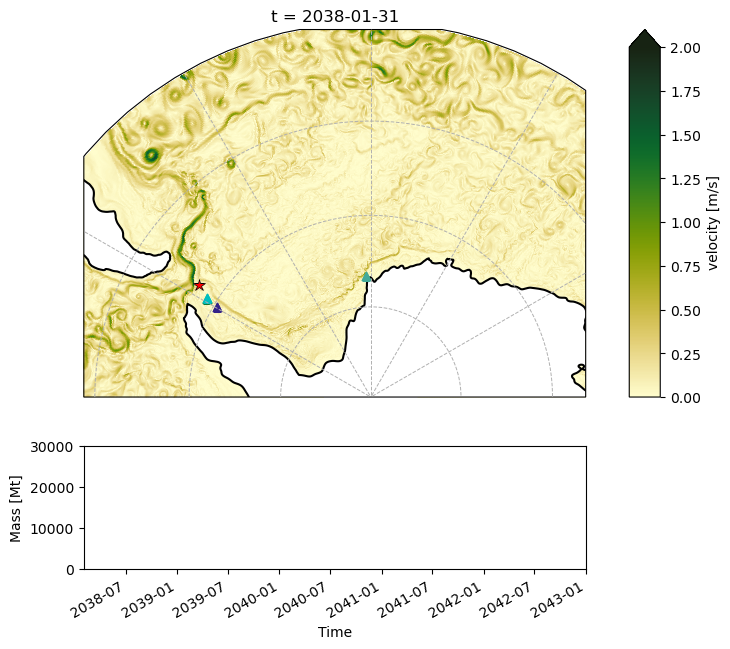

In [70]:
### Define the figure and axis
fig = plt.figure(figsize=(8,7))

gs = GridSpec(2, 1, height_ratios=[3,1])   # one overall figure: 2 row, 2 column
gs0 = GridSpecFromSubplotSpec(1, 2, subplot_spec=gs[0], wspace=0.0, width_ratios=(19, 1))   # fill top row: 1 row, 2 columns
gs1 = GridSpecFromSubplotSpec(1, 3, subplot_spec=gs[1], wspace=0.0, width_ratios=(1.4, 16.2, 2.4))   # fill bottom row: 1 rows, 2 columns

# initialize the cartopy and colorbar axes
ax = fig.add_subplot(gs0[0,0], projection=ccrs.SouthPolarStereo())
cb_ax = fig.add_subplot(gs0[0,1])
m_ax = fig.add_subplot(gs1[0,1])

# Adapt border
ax.set_extent([-50, 35, -90, -50], ccrs.PlateCarree())
ylim = [-90,-50]
xlim = [-90,90]
rect = mpath.Path([[xlim[0], ylim[0]],
                   [xlim[1], ylim[0]],
                   [xlim[1], ylim[1]],
                   [xlim[0], ylim[1]],
                   [xlim[0], ylim[0]],
                   ]).interpolated(40)
proj_to_data   = ccrs.PlateCarree()._as_mpl_transform(ax) - ax.transData
rect_in_target = proj_to_data.transform_path(rect)
ax.set_boundary(rect_in_target)

# ODP Site 696
ax.plot(x696, y696, color='r', marker='*', markersize=9, markeredgecolor='black', markeredgewidth=.5,
        transform=ccrs.PlateCarree(), zorder=3)

# Coastlines
ax.contour(lons[:760,850:2700], lats[:760,850:2700], bath[:760,850:2700], levels=[0],
           transform=ccrs.PlateCarree(), colors='k', zorder=2)
ax.contourf(lons[:760,850:2700], lats[:760,850:2700], bath[:760,850:2700], levels=[0, 1e10],
            transform=ccrs.PlateCarree(), colors=['white'], zorder=1)
ax.scatter(1, -78.4, transform=ccrs.PlateCarree(), color='white', zorder=3, s=40)

# Gridlines
# -60, -30, 0, 30, 60 W/E (only lines)
gl0 = ax.gridlines(linestyle='--', linewidth=.7, draw_labels=False, x_inline=False, y_inline=False,
                   crs=ccrs.PlateCarree(), zorder=5)
gl0.xlocator = mticker.FixedLocator(np.arange(-60,61,30))
gl0.ylocator = mticker.FixedLocator([])
# 90, 80, 70, 60 S (only lines)
gl1 = ax.gridlines(linestyle='--', linewidth=.7, draw_labels=False, x_inline=False, y_inline=False,
                   crs=ccrs.PlateCarree(), zorder=5)
gl1.xlocator = mticker.FixedLocator([])
gl1.ylocator = mticker.FixedLocator(np.arange(-90,-59,10))
# 50 S (only lines)
gl2 = ax.gridlines(linestyle='-', linewidth=1, color='k', draw_labels=False, x_inline=False, y_inline=False,
                   crs=ccrs.PlateCarree(), zorder=5)
gl2.xlocator = mticker.FixedLocator([])
gl2.ylocator = mticker.FixedLocator(np.arange(-50,-49,10))

### Background (velocity)
tm = str(data_xarray['time'].values[0,0])[2:4] + str(data_xarray['time'].values[0,0])[5:7] + str(data_xarray['time'].values[0,0])[8:10]
ds = xr.open_dataset(f'/storage/shared/pop/p21a.EO38Ma.tx0.1.2pic_control/daily/vars_first600m_eocene_2pic_pop_00{tm}.nc')
data = np.sqrt((ds['UVEL'][0,0,:750,:])**2 + (ds['VVEL'][0,0,:750,:])**2) / 100.
kw = dict(cmap=cmo.cm.speed, vmin=0, vmax=2, shading='flat')

cm = ax.pcolormesh(grid['U_LON_2D'][:750,:], grid['U_LAT_2D'][:750,:], data[:-1,:-1], transform=ccrs.PlateCarree(), **kw, zorder=0)
                    # cmap=cmo.cm.speed, vmin=0, vmax=2, shading='flat')

### Iceberg position
scatter0 = ax.scatter(data_xarray['lon'].values[0,time_id], data_xarray['lat'].values[0,time_id],
                     transform=ccrs.PlateCarree(), marker='^', color='#332288', zorder=2)#117733
scatter1 = ax.scatter(data_xarray['lon'].values[1,time_id], data_xarray['lat'].values[1,time_id],
                     transform=ccrs.PlateCarree(), marker='^', color='#117733', zorder=2)
scatter2 = ax.scatter(data_xarray['lon'].values[2,time_id], data_xarray['lat'].values[2,time_id],
                     transform=ccrs.PlateCarree(), marker='^', color='#44AA99', zorder=2)
scatter3 = ax.scatter(data_xarray['lon'].values[3,time_id], data_xarray['lat'].values[3,time_id],
                     transform=ccrs.PlateCarree(), marker='^', color='c', zorder=2)
### Trajectory
traj0, = ax.plot(data_xarray['lon'].values[0,time_id], data_xarray['lat'].values[0,time_id],
                     transform=ccrs.PlateCarree(), color='#332288', zorder=1)
traj1, = ax.plot(data_xarray['lon'].values[1,time_id], data_xarray['lat'].values[1,time_id],
                     transform=ccrs.PlateCarree(), color='#117733', zorder=1)
traj2, = ax.plot(data_xarray['lon'].values[2,time_id], data_xarray['lat'].values[2,time_id],
                     transform=ccrs.PlateCarree(), color='#44AA99', zorder=1)
traj3, = ax.plot(data_xarray['lon'].values[3,time_id], data_xarray['lat'].values[3,time_id],
                     transform=ccrs.PlateCarree(), color='darkcyan', zorder=1)

t = str(timerange[0].astype('datetime64[D]'))
title = ax.set_title('t = '+t)



#=================================================================================================#
### Colorbar
fig.colorbar(cm, cax=cb_ax, orientation='vertical', label=r'velocity [m/s]', extend='max')


#=================================================================================================#
### Mass
mass0, = m_ax.plot(data_xarray['time'].values[0,time_id], data_xarray['M'].values[0,time_id]*1e-9,
                     color='darkcyan')
mass1, = m_ax.plot([], [],#data_xarray['time'].values[1,time_id], data_xarray['M'].values[1,time_id]*1e-9,
                     color='darkcyan')
mass2, = m_ax.plot([], [],#data_xarray['time'].values[2,time_id], data_xarray['M'].values[2,time_id]*1e-9,
                     color='darkcyan')
mass3, = m_ax.plot([], [],#data_xarray['time'].values[3,time_id], data_xarray['M'].values[3,time_id]*1e-9,
                     color='darkcyan')
m_ax.set_ylim(0,30000)
m_ax.set_ylabel('Mass [Mt]')
m_ax.set_xlim(np.nanmin(data_xarray['time'].values), np.datetime64('2043-01-01T00:00:00.000000000'))#np.nanmax(data_xarray['time'].values))
m_ax.set_xlabel('Time')
for label in m_ax.get_xticklabels(which='major'):
    label.set(rotation=30, horizontalalignment='right')


#=================================================================================================#
def animate(i):
    t = str(timerange[i].astype('datetime64[D]'))
    title.set_text('t = '+t)
    
    time_id = np.where(data_xarray['time'] == timerange[i])
    
    tm = str(data_xarray['time'].values[0,i])[2:4] + str(data_xarray['time'].values[0,i])[5:7] + str(data_xarray['time'].values[0,0])[8:10]
    if tm != '380431':
        ds = xr.open_dataset(f'/storage/shared/pop/p21a.EO38Ma.tx0.1.2pic_control/daily/vars_first600m_eocene_2pic_pop_00{tm}.nc')
        data = np.sqrt((ds['UVEL'][0,0,:750,:])**2 + (ds['VVEL'][0,0,:750,:])**2) / 100.
        cm.set_array(data[:-1,:-1])
    
    scatter0.set_offsets(np.c_[data_xarray['lon'].values[0,time_id], data_xarray['lat'].values[0,time_id]])
    traj0.set_data(data_xarray['lon'].values[:,:i+1], data_xarray['lat'].values[:,:i+1])
    scatter1.set_offsets(np.c_[data_xarray['lon'].values[1,time_id], data_xarray['lat'].values[1,time_id]])
    traj1.set_data(data_xarray['lon'].values[:,:i+1], data_xarray['lat'].values[:,:i+1])
    scatter2.set_offsets(np.c_[data_xarray['lon'].values[2,time_id], data_xarray['lat'].values[2,time_id]])
    traj2.set_data(data_xarray['lon'].values[:,:i+1], data_xarray['lat'].values[:,:i+1])
    scatter3.set_offsets(np.c_[data_xarray['lon'].values[3,time_id], data_xarray['lat'].values[3,time_id]])
    traj3.set_data(data_xarray['lon'].values[:,:i+1], data_xarray['lat'].values[:,:i+1])
    
    # Mass
    mass0.set_data(data_xarray['time'].values[0,:i+1], data_xarray['M'].values[0,:i+1]*1e-9)
    mass1.set_data(data_xarray['time'].values[1,:i+1], data_xarray['M'].values[1,:i+1]*1e-9)
    mass2.set_data(data_xarray['time'].values[2,:i+1], data_xarray['M'].values[2,:i+1]*1e-9)
    mass3.set_data(data_xarray['time'].values[3,:i+1], data_xarray['M'].values[3,:i+1]*1e-9)

anim = FuncAnimation(fig, animate, frames = len(timerange), interval=750)

In [24]:
t = str(timerange[0].astype('datetime64[D]'))

for i in range(len(timerange)):
    t = str(timerange[i].astype('datetime64[D]'))
    
    time_id = np.where(data_xarray['time'] == timerange[i])
    
    tm = str(timerange[i])[2:4] + str(timerange[i])[5:7] + str(timerange[i])[8:10]
    print(i, t, tm)
#     if (tm != '380431') or (tm != '380631'):
#         ds = xr.open_dataset(f'/storage/shared/pop/p21a.EO38Ma.tx0.1.2pic_control/daily/vars_first600m_eocene_2pic_pop_00{tm}.nc')
#         data = np.sqrt((ds['UVEL'][0,0,:750,:])**2 + (ds['VVEL'][0,0,:750,:])**2) / 100.

# anim = FuncAnimation(fig, animate, frames = len(timerange), interval=750)

0 2038-01-31 380131
1 2038-03-02 380302
2 2038-04-01 380401
3 2038-05-01 380501
4 2038-05-31 380531
5 2038-06-30 380630
6 2038-07-30 380730
7 2038-08-29 380829
8 2038-09-28 380928
9 2038-10-28 381028
10 2038-11-27 381127
11 2038-12-27 381227
12 2039-01-26 390126
13 2039-02-25 390225
14 2039-03-27 390327
15 2039-04-26 390426
16 2039-05-26 390526
17 2039-06-25 390625
18 2039-07-25 390725
19 2039-08-24 390824
20 2039-09-23 390923
21 2039-10-23 391023
22 2039-11-22 391122
23 2039-12-22 391222
24 2040-01-21 400121
25 2040-02-20 400220
26 2040-03-21 400321
27 2040-04-20 400420
28 2040-05-20 400520
29 2040-06-19 400619
30 2040-07-19 400719
31 2040-08-18 400818
32 2040-09-17 400917
33 2040-10-17 401017
34 2040-11-16 401116
35 2040-12-16 401216
36 2041-01-15 410115
37 2041-02-14 410214
38 2041-03-16 410316
39 2041-04-15 410415
40 2041-05-15 410515
41 2041-06-14 410614
42 2041-07-14 410714


KeyboardInterrupt: 

In [25]:
HTML(anim.to_jshtml())

0 2038-01-31 380131
0 2038-01-31 380131
1 2038-03-02 380302
2 2038-04-01 380401
3 2038-05-01 380501
4 2038-05-31 380531
5 2038-06-30 380630
6 2038-07-30 380730
7 2038-08-29 380829
8 2038-09-28 380928
9 2038-10-28 381028
10 2038-11-27 381127


In [ ]:
f = r'/nethome/5867800/active/animation_multiple.mp4'
writervideo = matplotlib.animation.FFMpegWriter(fps=12) 
anim.save(f, writer=writervideo,dpi=600)